In [1]:
import numpy as np
import torch
import matplotlib.pyplot as plt
import cv2

In [2]:
def show_mask(mask, ax, random_color=False, text=None):
    if random_color:
        color = np.concatenate([np.random.random(3), np.array([0.6])], axis=0)
    else:
        color = np.array([30/255, 144/255, 255/255, 0.6])
    h, w = mask.shape[-2:]
    mask_image = mask.reshape(h, w, 1) * color.reshape(1, 1, -1)
    if text != None:
        ax.set_title(text, fontsize=15)
    ax.imshow(mask_image)
    ax.axis('off')
    
def show_points(coords, labels, ax, marker_size=375):
    pos_points = coords[labels==1]
    neg_points = coords[labels==0]
    ax.scatter(pos_points[:, 0], pos_points[:, 1], color='green', marker='*', s=marker_size, edgecolor='white', linewidth=1.25)
    ax.scatter(neg_points[:, 0], neg_points[:, 1], color='red', marker='*', s=marker_size, edgecolor='white', linewidth=1.25)   
    
def show_box(box, ax):
    x0, y0 = box[0], box[1]
    w, h = box[2] - box[0], box[3] - box[1]
    ax.add_patch(plt.Rectangle((x0, y0), w, h, edgecolor='green', facecolor=(0,0,0,0), lw=2))    


In [3]:
image = cv2.imread('images/truck.jpg')
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

In [4]:
sam_checkpoint = "/home/xaiplanet/new_workspace/SAM_meta/segment-anything/sam_vit_h_4b8939.pth"
device = "cuda"
model_type = "default"

In [5]:
import sys
sys.path.append("..")
from segment_anything import sam_model_registry, SamPredictor

sam = sam_model_registry[model_type](checkpoint=sam_checkpoint)
sam.to(device=device)

predictor = SamPredictor(sam)

Sam(
  (image_encoder): ImageEncoderViT(
    (patch_embed): PatchEmbed(
      (proj): Conv2d(3, 1280, kernel_size=(16, 16), stride=(16, 16))
    )
    (blocks): ModuleList(
      (0): Block(
        (norm1): LayerNorm((1280,), eps=1e-06, elementwise_affine=True)
        (attn): Attention(
          (qkv): Linear(in_features=1280, out_features=3840, bias=True)
          (proj): Linear(in_features=1280, out_features=1280, bias=True)
        )
        (norm2): LayerNorm((1280,), eps=1e-06, elementwise_affine=True)
        (mlp): MLPBlock(
          (lin1): Linear(in_features=1280, out_features=5120, bias=True)
          (lin2): Linear(in_features=5120, out_features=1280, bias=True)
          (act): GELU()
        )
      )
      (1): Block(
        (norm1): LayerNorm((1280,), eps=1e-06, elementwise_affine=True)
        (attn): Attention(
          (qkv): Linear(in_features=1280, out_features=3840, bias=True)
          (proj): Linear(in_features=1280, out_features=1280, bias=True)
        

## 모델에 이미지 세팅

In [6]:
predictor.set_image(image)

### 1. point promt 설정

In [7]:
input_point = np.array([[500, 375]])
input_label = np.array([1])

- multimask 사용

In [8]:
masks, scores, logits = predictor.predict(
    point_coords=input_point,
    point_labels=input_label,
    multimask_output=True,
)

masks.shape  # (number_of_masks) x H x W

(3, 1200, 1800)

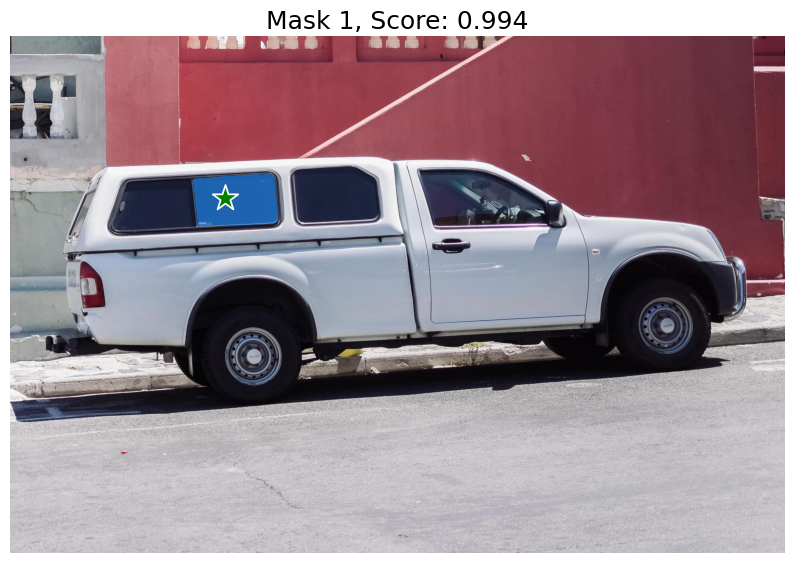

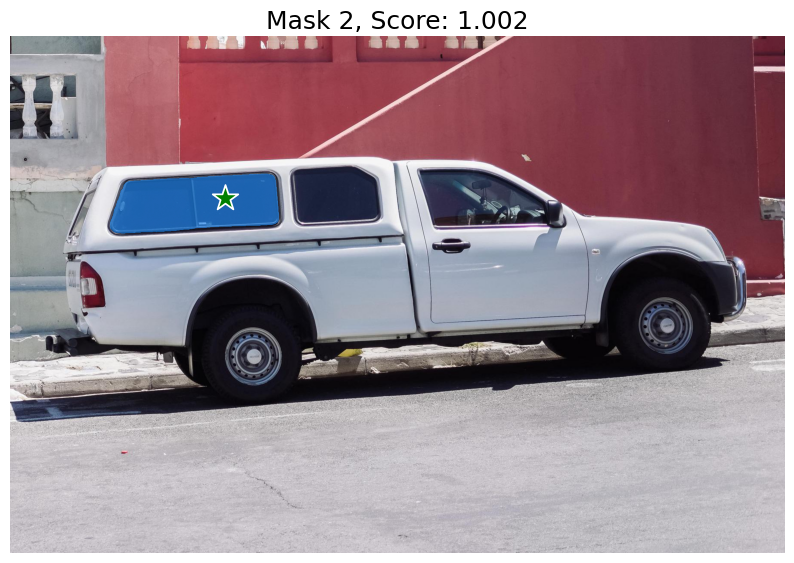

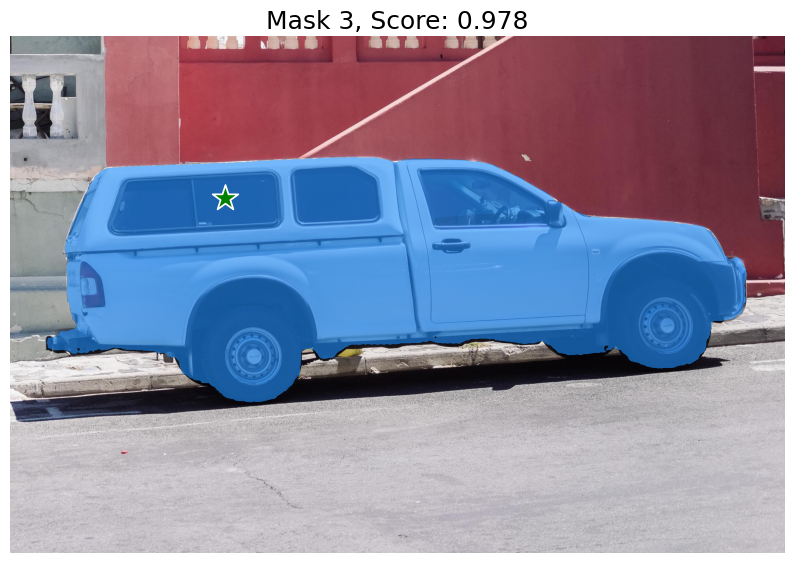

In [9]:
for i, (mask, score) in enumerate(zip(masks, scores)):
    plt.figure(figsize=(10,10))
    plt.imshow(image)
    show_mask(mask, plt.gca())
    show_points(input_point, input_label, plt.gca())
    plt.title(f"Mask {i+1}, Score: {score:.3f}", fontsize=18)
    plt.axis('off')
    plt.show()  

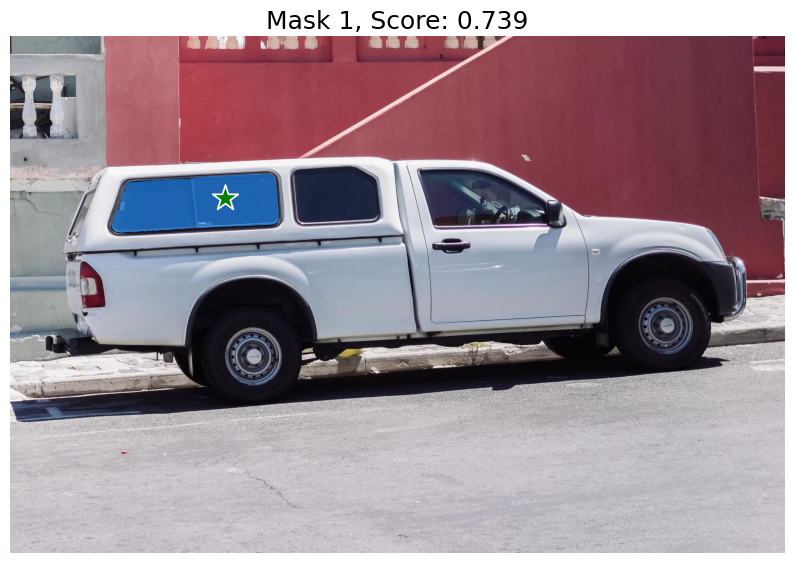

In [10]:
masks, scores, logits = predictor.predict(
    point_coords=input_point,
    point_labels=input_label,
    multimask_output=False,
)

masks.shape  # (number_of_masks) x H x W

for i, (mask, score) in enumerate(zip(masks, scores)):
    plt.figure(figsize=(10,10))
    plt.imshow(image)
    show_mask(mask, plt.gca())
    show_points(input_point, input_label, plt.gca())
    plt.title(f"Mask {i+1}, Score: {score:.3f}", fontsize=18)
    plt.axis('off')
    plt.show()  

### 2. multil prompt 설정

싱글 포인트 입력 지점이 모호하고 모델이 이에 일치하는 여러 개체를 반환한 경우에 <br>
단일 객체를 얻기 위해 여러 점을 제공할 수 있다. <br>
이전 iteration으로 부터 마스크를 모델에 제공하여 예측에 도움을 줄 수도 있다. <br>
여러 프롬프트가 있는 단일 객체를 지정할 때 `multimask_output=False`를 설정하여 단일 마스크를 출력할 수 있다.

In [11]:
# input_point = np.array([[500, 375], [1125, 625]])
input_point = np.array([[500, 375], [510, 395]])
input_label = np.array([1, 1])

# mask_input = logits[np.argmax(scores), :, :]  # Choose the model's best mask

In [12]:
masks, scores, logits = predictor.predict(
    point_coords=input_point,
    point_labels=input_label,
    # mask_input=mask_input[None, :, :,],
    multimask_output=True,
)

masks.shape

(3, 1200, 1800)

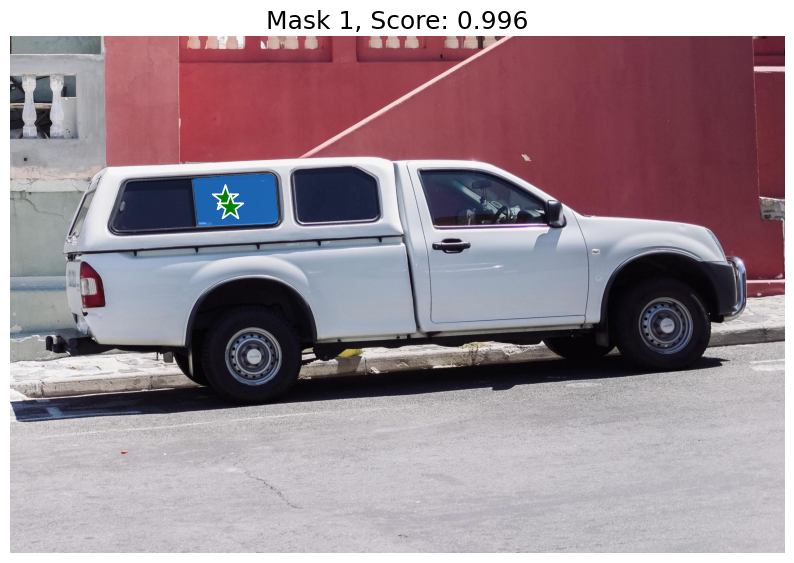

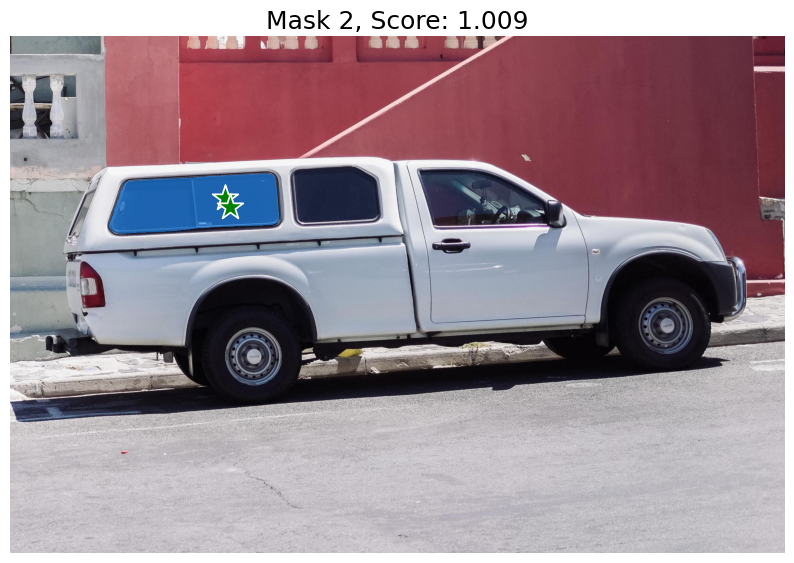

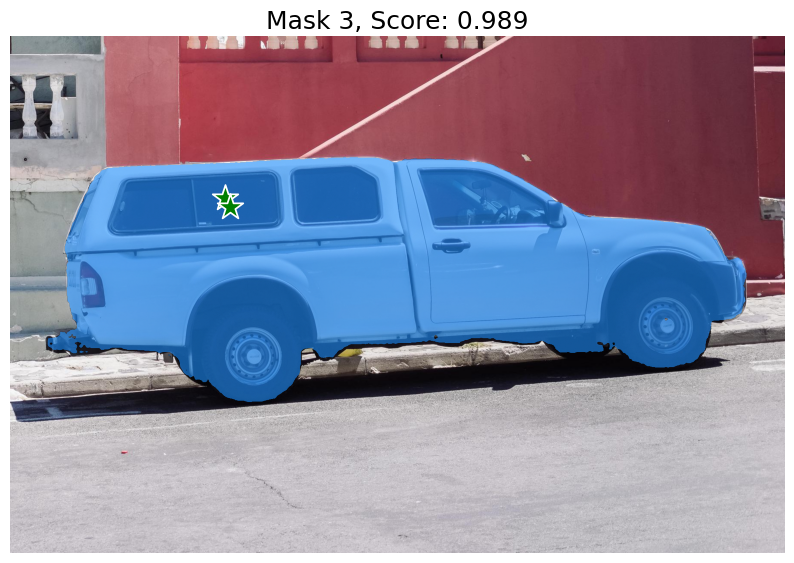

In [43]:
for i, (mask, score) in enumerate(zip(masks, scores)):
    plt.figure(figsize=(10,10))
    plt.imshow(image)
    show_mask(mask, plt.gca())
    show_points(input_point, input_label, plt.gca())
    plt.title(f"Mask {i+1}, Score: {score:.3f}", fontsize=18)
    plt.axis('off')
    plt.show()  

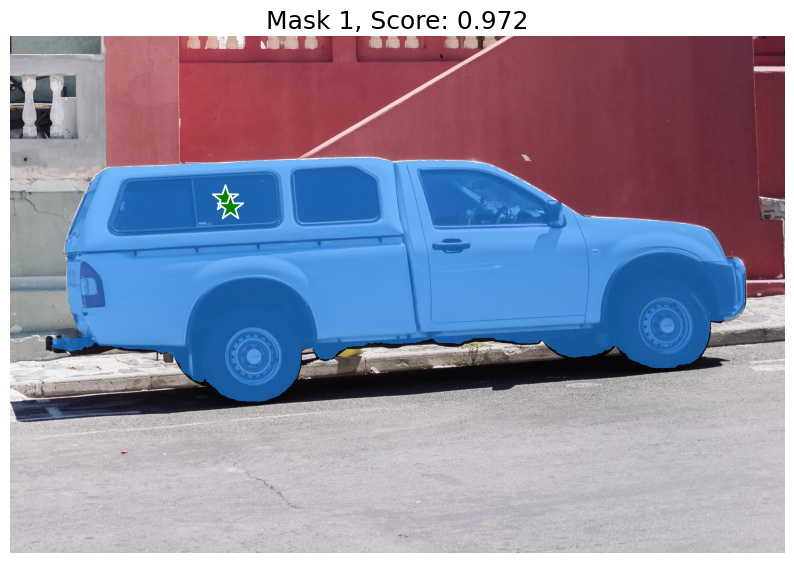

In [22]:
# input_point = np.array([[500, 375], [1125, 625]])
input_point = np.array([[500, 375], [510, 395]])
input_label = np.array([1, 1])

mask_input = logits[np.argmax(scores), :, :]  # Choose the model's best mask

masks, scores, logits = predictor.predict(
    point_coords=input_point,
    point_labels=input_label,
    mask_input=mask_input[None, :, :,],
    multimask_output=False,
)

masks.shape

for i, (mask, score) in enumerate(zip(masks, scores)):
    plt.figure(figsize=(10,10))
    plt.imshow(image)
    show_mask(mask, plt.gca())
    show_points(input_point, input_label, plt.gca())
    plt.title(f"Mask {i+1}, Score: {score:.3f}", fontsize=18)
    plt.axis('off')
    plt.show()  

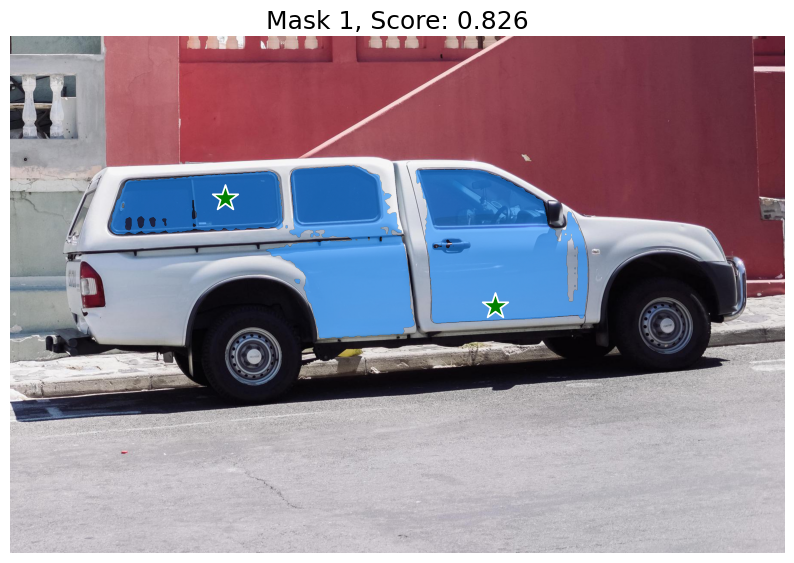

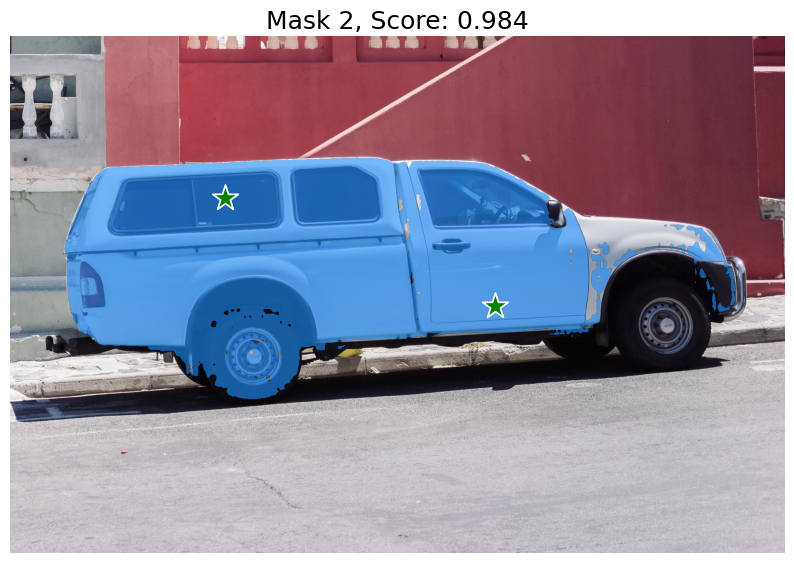

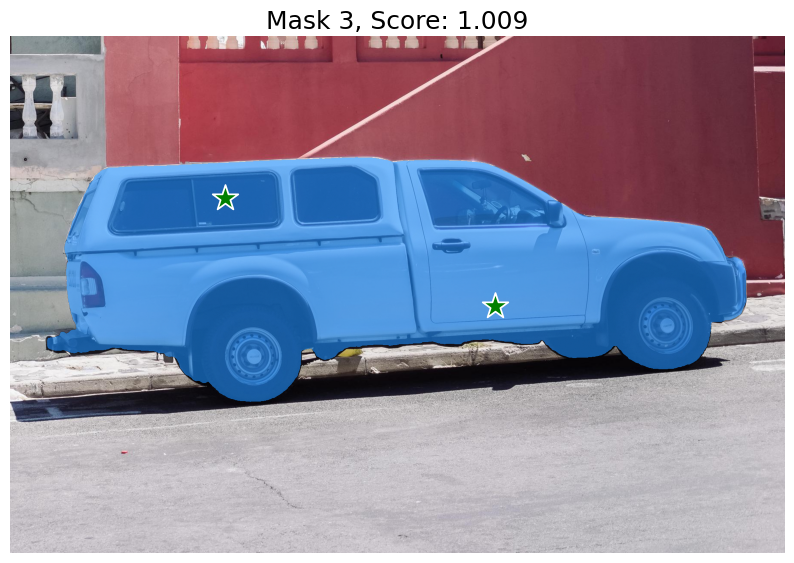

In [21]:
input_point = np.array([[500, 375], [1125, 625]])

input_label = np.array([1, 1])


masks, scores, logits = predictor.predict(
    point_coords=input_point,
    point_labels=input_label,
    multimask_output=True,
)

masks.shape

for i, (mask, score) in enumerate(zip(masks, scores)):
    plt.figure(figsize=(10,10))
    plt.imshow(image)
    show_mask(mask, plt.gca())
    show_points(input_point, input_label, plt.gca())
    plt.title(f"Mask {i+1}, Score: {score:.3f}", fontsize=18)
    plt.axis('off')
    plt.show()  

In [ ]:
class PromptEncoder(nn.Module):
    def __init__(
        self,
        embed_dim: int,
        image_embedding_size: Tuple[int, int],
        input_image_size: Tuple[int, int],
        mask_in_chans: int,
        activation: Type[nn.Module] = nn.GELU,
    ) -> None:
        """
        Encodes prompts for input to SAM's mask decoder.

        Arguments:
          embed_dim (int): The prompts' embedding dimension
          image_embedding_size (tuple(int, int)): The spatial size of the
            image embedding, as (H, W).
          input_image_size (int): The padded size of the image as input
            to the image encoder, as (H, W).
          mask_in_chans (int): The number of hidden channels used for
            encoding input masks.
          activation (nn.Module): The activation to use when encoding
            input masks.
        """
        super().__init__()
        self.embed_dim = embed_dim
        self.input_image_size = input_image_size
        self.image_embedding_size = image_embedding_size
        self.pe_layer = PositionEmbeddingRandom(embed_dim // 2)

        self.num_point_embeddings: int = 4  # pos/neg point + 2 box corners
        point_embeddings = [nn.Embedding(1, embed_dim) for i in range(self.num_point_embeddings)]
        self.point_embeddings = nn.ModuleList(point_embeddings)
        self.not_a_point_embed = nn.Embedding(1, embed_dim)

        self.mask_input_size = (4 * image_embedding_size[0], 4 * image_embedding_size[1])
        self.mask_downscaling = nn.Sequential(
            nn.Conv2d(1, mask_in_chans // 4, kernel_size=2, stride=2),
            LayerNorm2d(mask_in_chans // 4),
            activation(),
            nn.Conv2d(mask_in_chans // 4, mask_in_chans, kernel_size=2, stride=2),
            LayerNorm2d(mask_in_chans),
            activation(),
            nn.Conv2d(mask_in_chans, embed_dim, kernel_size=1),
        )
        self.no_mask_embed = nn.Embedding(1, embed_dim)

    def get_dense_pe(self) -> torch.Tensor:
        """
        Returns the positional encoding used to encode point prompts,
        applied to a dense set of points the shape of the image encoding.

        Returns:
          torch.Tensor: Positional encoding with shape
            1x(embed_dim)x(embedding_h)x(embedding_w)
        """
        return self.pe_layer(self.image_embedding_size).unsqueeze(0)
      
      def _embed_points(
      self,
      points: torch.Tensor,
      labels: torch.Tensor,
      pad: bool,
  ) -> torch.Tensor:
      """Embeds point prompts."""
      points = points + 0.5  # Shift to center of pixel
      if pad:
          padding_point = torch.zeros((points.shape[0], 1, 2), device=points.device)
          padding_label = -torch.ones((labels.shape[0], 1), device=labels.device)
          points = torch.cat([points, padding_point], dim=1)
          labels = torch.cat([labels, padding_label], dim=1)
      point_embedding = self.pe_layer.forward_with_coords(points, self.input_image_size)
      point_embedding[labels == -1] = 0.0
      point_embedding[labels == -1] += self.not_a_point_embed.weight
      point_embedding[labels == 0] += self.point_embeddings[0].weight
      point_embedding[labels == 1] += self.point_embeddings[1].weight
      return point_embedding
    
    
    
    
    
    
    
     def forward(
        self,
        image_embeddings: torch.Tensor,
        image_pe: torch.Tensor,
        sparse_prompt_embeddings: torch.Tensor,
        dense_prompt_embeddings: torch.Tensor,
        multimask_output: bool,
    ) -> Tuple[torch.Tensor, torch.Tensor]:
        """
        Predict masks given image and prompt embeddings.

        Arguments:
          image_embeddings (torch.Tensor): the embeddings from the image encoder
          image_pe (torch.Tensor): positional encoding with the shape of image_embeddings
          sparse_prompt_embeddings (torch.Tensor): the embeddings of the points and boxes
          dense_prompt_embeddings (torch.Tensor): the embeddings of the mask inputs
          multimask_output (bool): Whether to return multiple masks or a single
            mask.

        Returns:
          torch.Tensor: batched predicted masks
          torch.Tensor: batched predictions of mask quality
        """
        masks, iou_pred = self.predict_masks(
            image_embeddings=image_embeddings,
            image_pe=image_pe,
            sparse_prompt_embeddings=sparse_prompt_embeddings,
            dense_prompt_embeddings=dense_prompt_embeddings,
        )

        # Select the correct mask or masks for output
        if multimask_output:
            mask_slice = slice(1, None)
        else:
            mask_slice = slice(0, 1)
        masks = masks[:, mask_slice, :, :]
        iou_pred = iou_pred[:, mask_slice]

        # Prepare output
        return masks, iou_pred

    def predict_masks(
        self,
        image_embeddings: torch.Tensor,
        image_pe: torch.Tensor,
        sparse_prompt_embeddings: torch.Tensor,
        dense_prompt_embeddings: torch.Tensor,
    ) -> Tuple[torch.Tensor, torch.Tensor]:
        """Predicts masks. See 'forward' for more details."""
        # Concatenate output tokens
        output_tokens = torch.cat([self.iou_token.weight, self.mask_tokens.weight], dim=0)
        output_tokens = output_tokens.unsqueeze(0).expand(sparse_prompt_embeddings.size(0), -1, -1)
        tokens = torch.cat((output_tokens, sparse_prompt_embeddings), dim=1)

        # Expand per-image data in batch direction to be per-mask
        src = torch.repeat_interleave(image_embeddings, tokens.shape[0], dim=0)
        src = src + dense_prompt_embeddings
        pos_src = torch.repeat_interleave(image_pe, tokens.shape[0], dim=0)
        b, c, h, w = src.shape

        # Run the transformer
        hs, src = self.transformer(src, pos_src, tokens)
        iou_token_out = hs[:, 0, :]
        mask_tokens_out = hs[:, 1 : (1 + self.num_mask_tokens), :]

        # Upscale mask embeddings and predict masks using the mask tokens
        src = src.transpose(1, 2).view(b, c, h, w)
        upscaled_embedding = self.output_upscaling(src)
        hyper_in_list: List[torch.Tensor] = []
        for i in range(self.num_mask_tokens):
            hyper_in_list.append(self.output_hypernetworks_mlps[i](mask_tokens_out[:, i, :]))
        hyper_in = torch.stack(hyper_in_list, dim=1)
        b, c, h, w = upscaled_embedding.shape
        masks = (hyper_in @ upscaled_embedding.view(b, c, h * w)).view(b, -1, h, w)

        # Generate mask quality predictions
        iou_pred = self.iou_prediction_head(iou_token_out)

        return masks, iou_pred
    

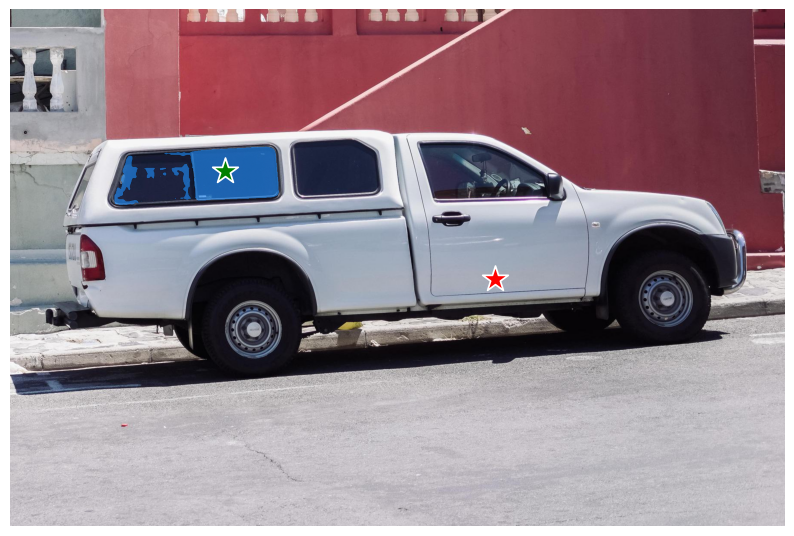

In [37]:
input_point = np.array([[500, 375], [1125, 625]])

input_label = np.array([1, 0])

mask_input = logits[np.argmax(scores), :, :]  # Choose the model's best mask

masks, _, _ = predictor.predict(
    point_coords=input_point,
    point_labels=input_label,
    mask_input=mask_input[None, :, :],
    multimask_output=False,
)

masks.shape

plt.figure(figsize=(10,10))
plt.imshow(image)
show_mask(masks, plt.gca())
show_points(input_point, input_label, plt.gca())
plt.axis('off')
plt.show() 

## 3. Boxes Prompt

- format: xyxy

In [48]:
input_box = np.array([425, 600, 700, 875])

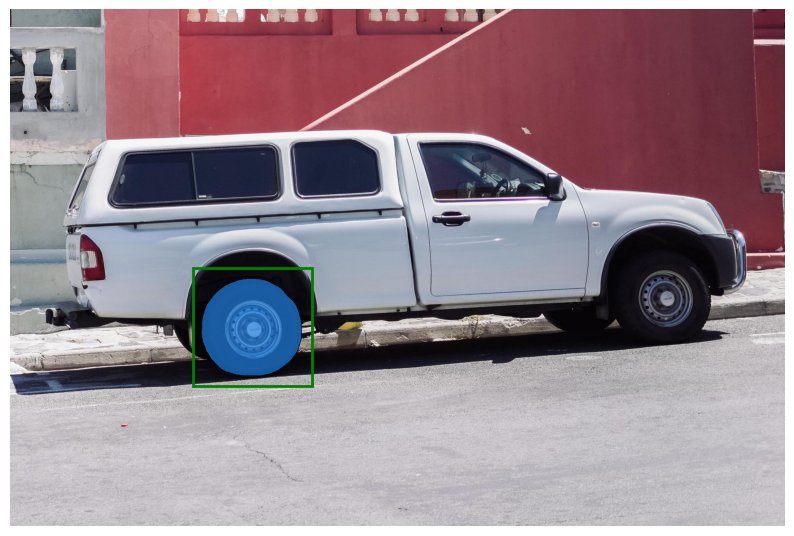

In [49]:
masks, _, _ = predictor.predict(
    point_coords=None,
    point_labels=None,
    box=input_box[None, :],
    multimask_output=False,
)

plt.figure(figsize=(10, 10))
plt.imshow(image)
show_mask(masks[0], plt.gca())
show_box(input_box, plt.gca())
plt.axis('off')
plt.show()

In [66]:
input_boxes = torch.tensor([
    [150, 275, 1650, 850],
    [425, 600, 650, 875],
    [1375, 550, 1580, 800],
    [1240, 675, 1400, 750],
], device=predictor.device)

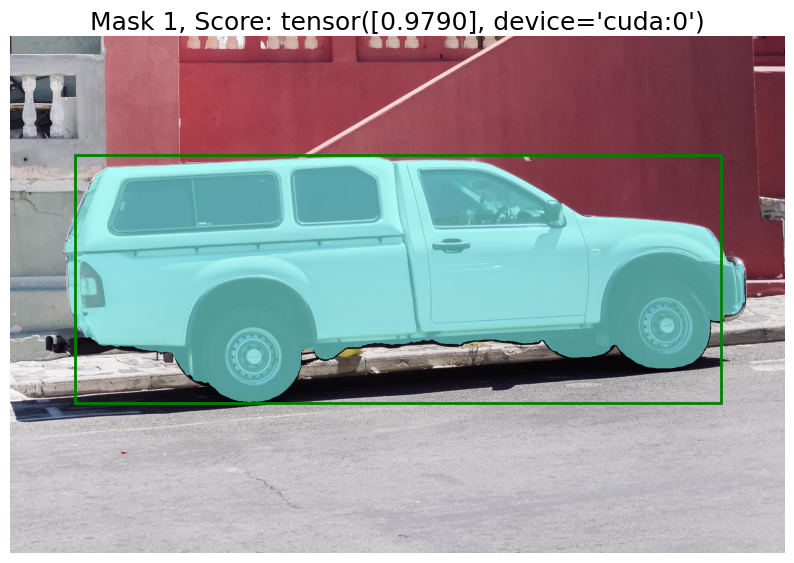

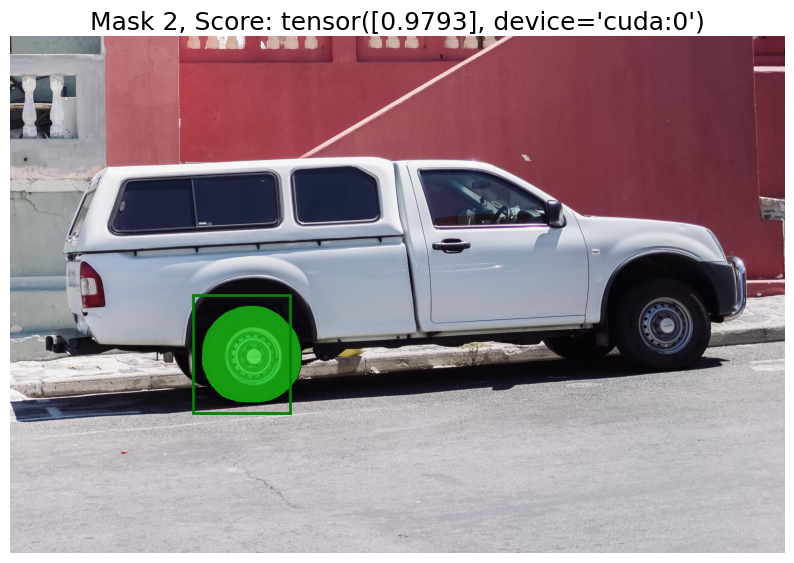

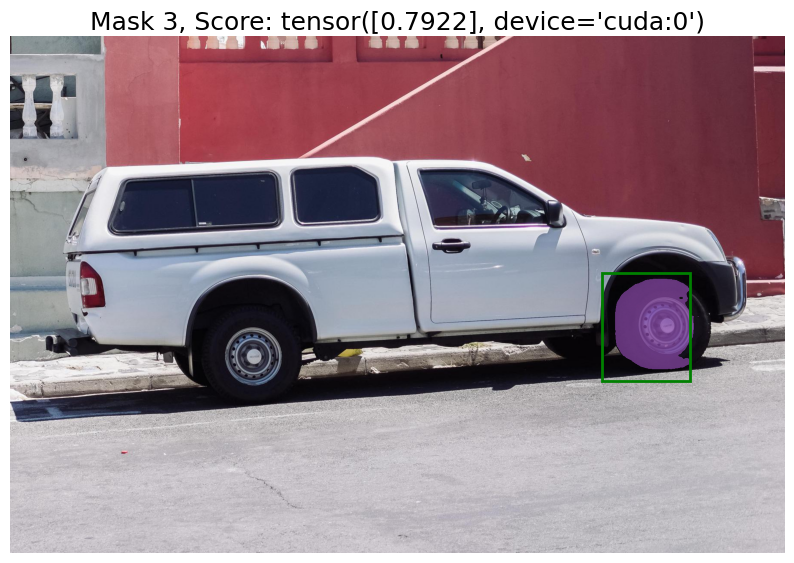

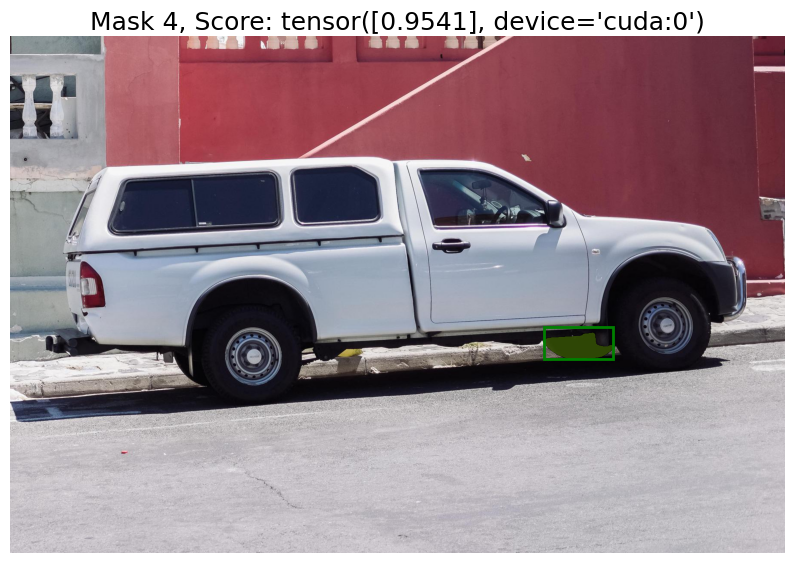

In [76]:
transformed_boxes = predictor.transform.apply_boxes_torch(input_boxes, image.shape[:2])
masks, scores, logits = predictor.predict_torch(
    point_coords=None,
    point_labels=None,
    boxes=transformed_boxes,
    multimask_output=False,
)

masks.shape  # (batch_size) x (num_predicted_masks_per_input) x H x W

for i, (mask, score, box) in enumerate(zip(masks, scores, input_boxes)):
    sc = score
    plt.figure(figsize=(10, 10))
    plt.imshow(image)
    for m in mask:
        show_mask(m.cpu().numpy(), plt.gca(), random_color=True)
    show_box(box.cpu().numpy(), plt.gca())
    plt.title(f"Mask {i+1}, Score: {sc}", fontsize=18)
    plt.axis('off')
    plt.show()

In [115]:
test = f"Mask {i+1}, box {j+1} Score: {score}"

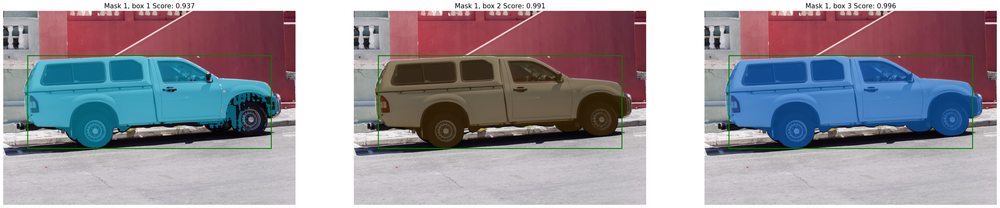

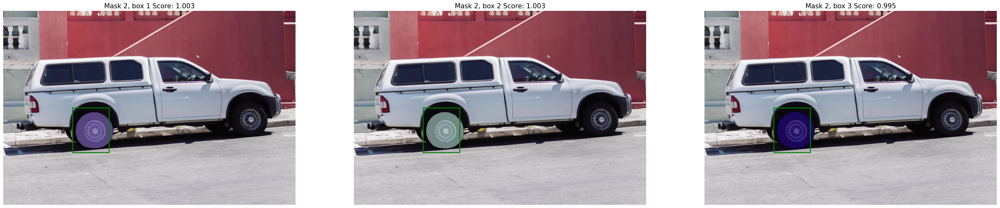

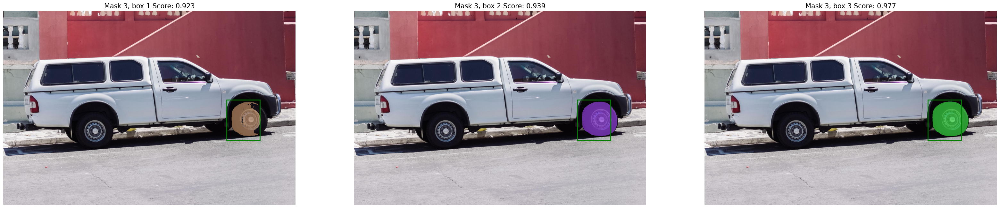

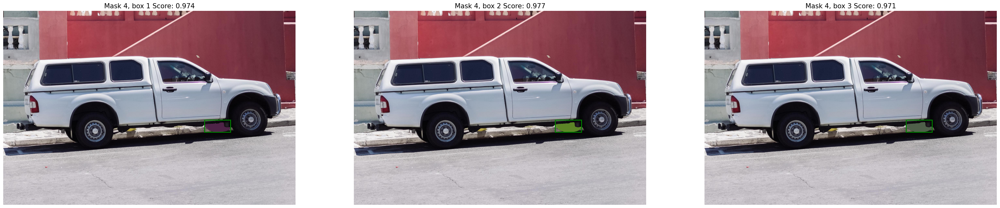

In [126]:
transformed_boxes = predictor.transform.apply_boxes_torch(input_boxes, image.shape[:2])
masks, scores, logits = predictor.predict_torch(
    point_coords=None,
    point_labels=None,
    boxes=transformed_boxes,
    multimask_output=True,
)

masks.shape  # (batch_size) x (num_predicted_masks_per_input) x H x W

for i, (mask, score, box) in enumerate(zip(masks, scores, input_boxes)):
    fig = plt.figure(figsize=(40, 40))
    plot = []
    for idx in range(3):
        plot.append(fig.add_subplot(1, 3, idx+1))
        plt.imshow(image)
    
    for j, (m, s, ax) in enumerate(zip(mask, score, plot)):
        sub_title = f"Mask {i+1}, box {j+1} Score: {s:.3f}"
        show_mask(m.cpu().numpy(), ax, random_color=True, text=sub_title)
        show_box(box.cpu().numpy(), ax)
    plt.show()

In [127]:
input_boxes = torch.tensor([
    [425, 600, 800, 850],
    [425, 600, 700, 875],
    [1375, 550, 1650, 800],
    [1375, 550, 1600, 750],
], device=predictor.device)

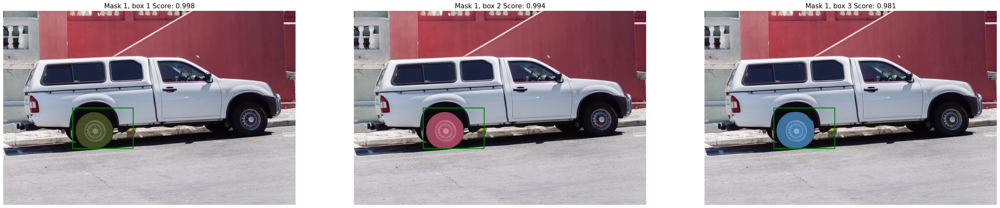

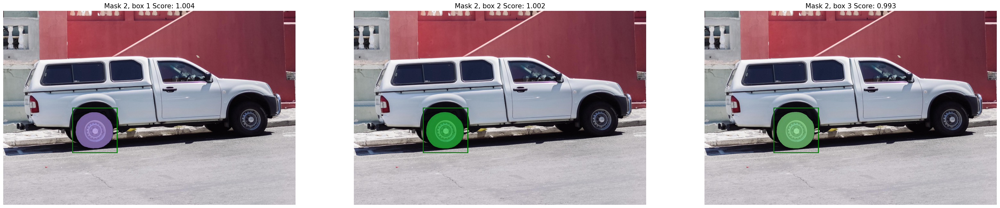

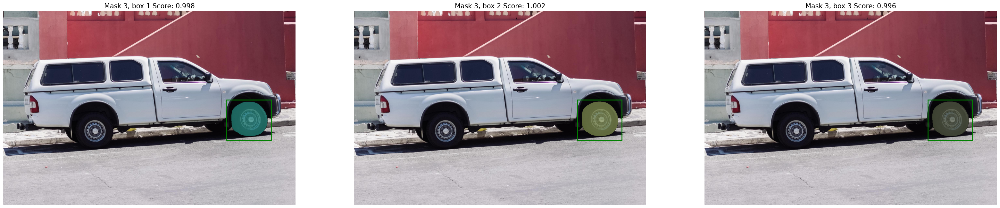

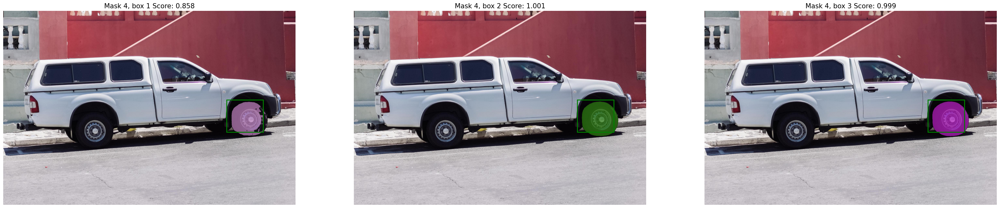

In [130]:
transformed_boxes = predictor.transform.apply_boxes_torch(input_boxes, image.shape[:2])
masks, scores, logits = predictor.predict_torch(
    point_coords=None,
    point_labels=None,
    boxes=transformed_boxes,
    multimask_output=True,
)

masks.shape  # (batch_size) x (num_predicted_masks_per_input) x H x W

for i, (mask, score, box) in enumerate(zip(masks, scores, input_boxes)):
    fig = plt.figure(figsize=(40, 40))
    plot = []
    for idx in range(3):
        plot.append(fig.add_subplot(1, 3, idx+1))
        plt.imshow(image)
    
    for j, (m, s, ax) in enumerate(zip(mask, score, plot)):
        sub_title = f"Mask {i+1}, box {j+1} Score: {s:.3f}"
        show_mask(m.cpu().numpy(), ax, random_color=True, text=sub_title)
        show_box(box.cpu().numpy(), ax)
    plt.show()

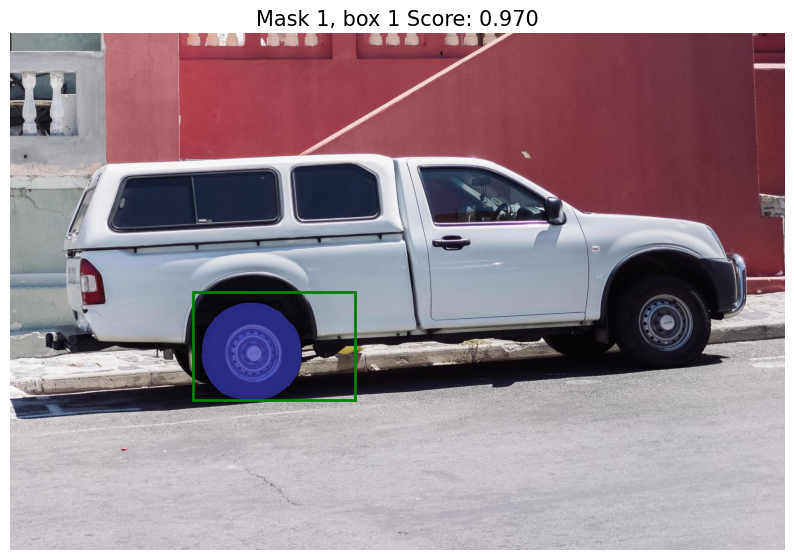

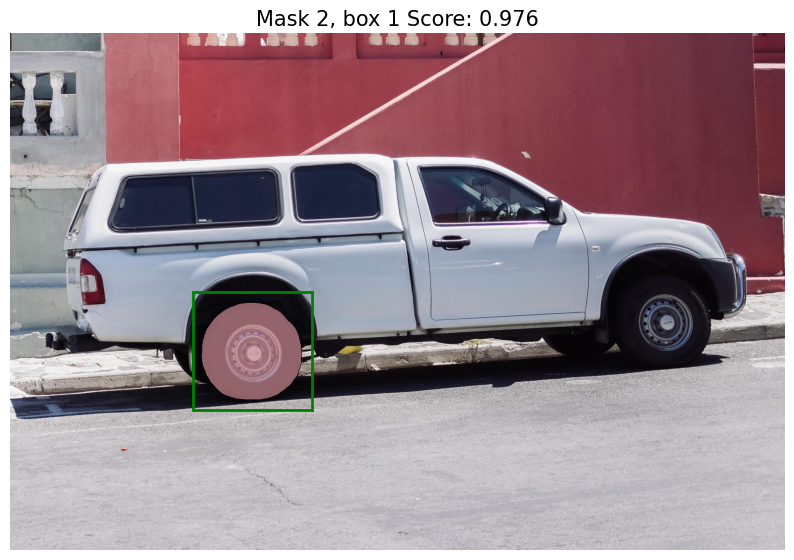

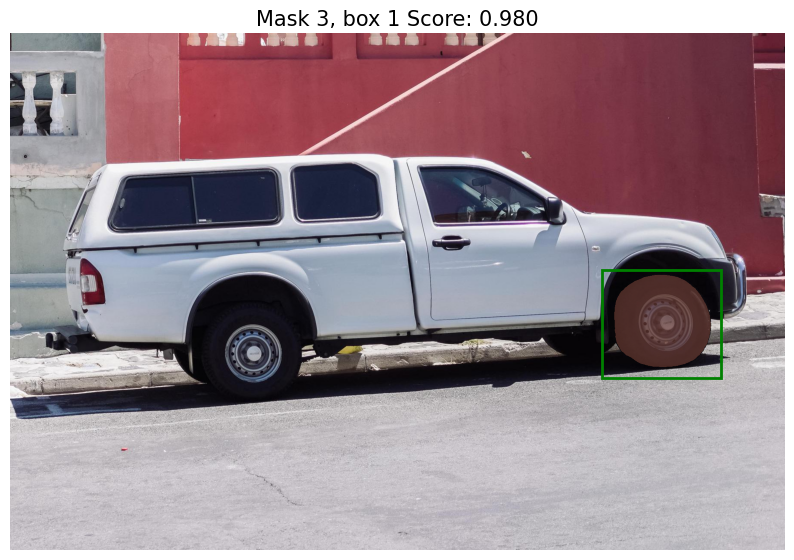

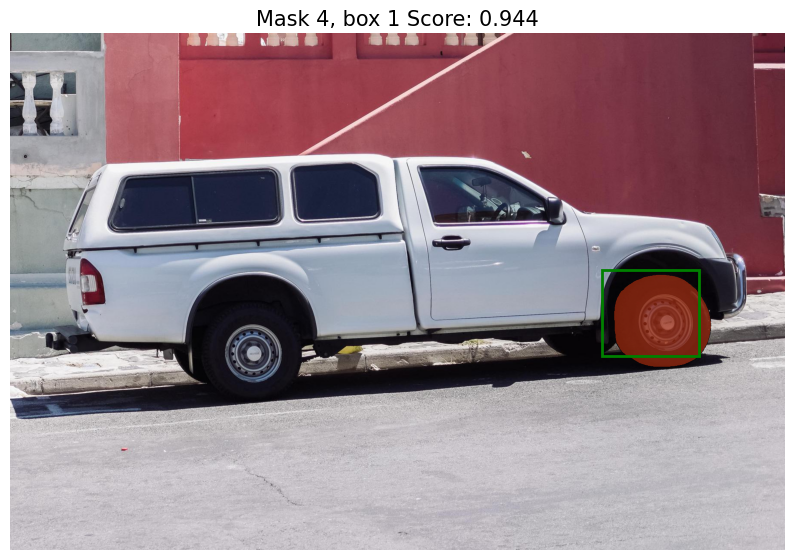

In [137]:
transformed_boxes = predictor.transform.apply_boxes_torch(input_boxes, image.shape[:2])
masks, scores, logits = predictor.predict_torch(
    point_coords=None,
    point_labels=None,
    boxes=transformed_boxes,
    multimask_output=False,
)

masks.shape  # (batch_size) x (num_predicted_masks_per_input) x H x W

for i, (mask, score, box) in enumerate(zip(masks, scores, input_boxes)):
    fig = plt.figure(figsize=(10, 10))
    plt.imshow(image)
    
    for j, (m, s) in enumerate(zip(mask, score)):
        sub_title = f"Mask {i+1}, box {j+1} Score: {s:.3f}"
        show_mask(m.cpu().numpy(), plt.gca(), random_color=True, text=sub_title)
        show_box(box.cpu().numpy(), plt.gca())
    plt.show()

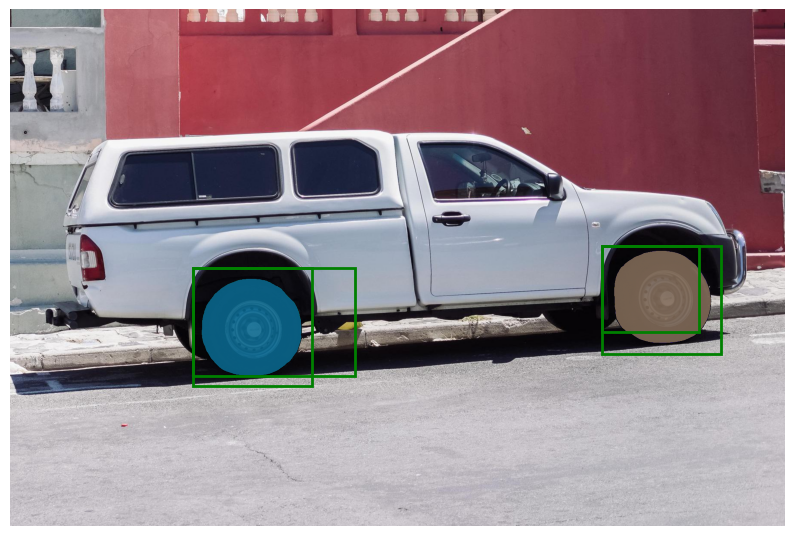

In [138]:
plt.figure(figsize=(10, 10))
plt.imshow(image)
for mask in masks:
    show_mask(mask.cpu().numpy(), plt.gca(), random_color=True)
for box in input_boxes:
    show_box(box.cpu().numpy(), plt.gca())
plt.axis('off')
plt.show()

In [ ]:
mask_input = logits[np.argmax(scores), :, :]  # Choose the model's best mask

### 4. points 와 boxes promts 입력

In [65]:
input_box = np.array([425, 600, 700, 875])
input_point = np.array([[575, 750]])
input_label = np.array([0])

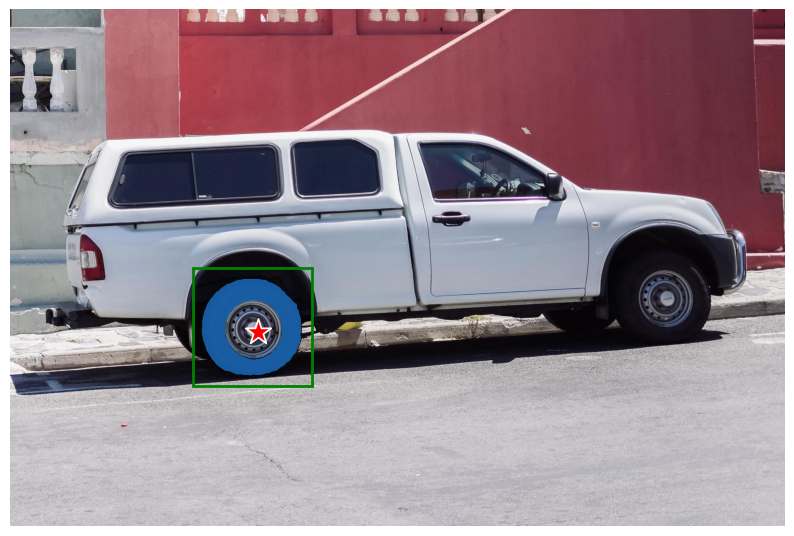

In [66]:
masks, _, _ = predictor.predict(
    point_coords=input_point,
    point_labels=input_label,
    box=input_box,
    multimask_output=False,
)

plt.figure(figsize=(10, 10))
plt.imshow(image)
show_mask(masks[0], plt.gca())
show_box(input_box, plt.gca())
show_points(input_point, input_label, plt.gca())
plt.axis('off')
plt.show()

In [67]:
input_box = np.array([425, 600, 700, 875])
input_point = np.array([[575, 750]])
input_label = np.array([1])

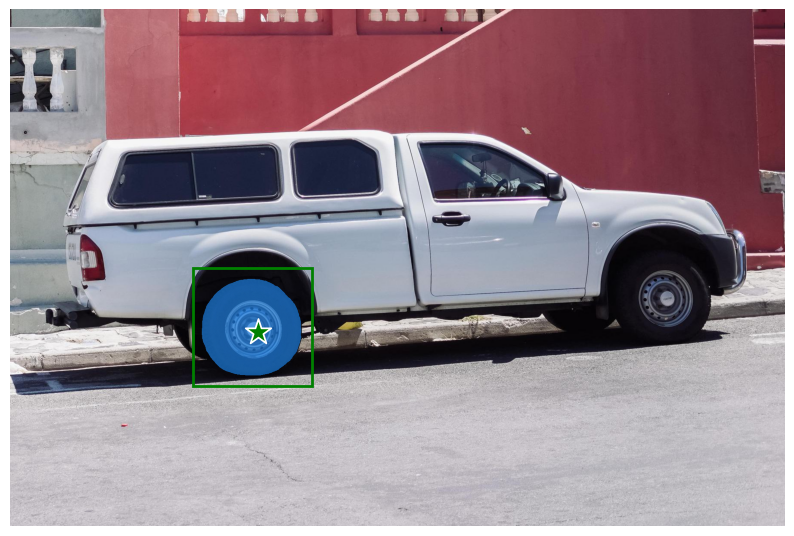

In [68]:
masks, _, _ = predictor.predict(
    point_coords=input_point,
    point_labels=input_label,
    box=input_box,
    multimask_output=False,
)

plt.figure(figsize=(10, 10))
plt.imshow(image)
show_mask(masks[0], plt.gca())
show_box(input_box, plt.gca())
show_points(input_point, input_label, plt.gca())
plt.axis('off')
plt.show()

In [103]:
image1 = image  # truck.jpg from above
image1_boxes = torch.tensor([
    [75, 275, 1725, 850],
    [425, 600, 700, 875],
    [1375, 550, 1650, 800],
    [1240, 675, 1400, 750],
], device=sam.device)
image1_points = torch.tensor([
    [400, 500],
    [666, 800],
], device=sam.device)
image1_points_labels = torch.tensor([1, 1], device=sam.device)

image2 = cv2.imread('images/groceries.jpg')
image2 = cv2.cvtColor(image2, cv2.COLOR_BGR2RGB)
image2_boxes = torch.tensor([
    [450, 170, 520, 350],
    [350, 190, 450, 350],
    [500, 170, 580, 350],
    [580, 170, 640, 350],
], device=sam.device)


In [104]:
from segment_anything.utils.transforms import ResizeLongestSide
resize_transform = ResizeLongestSide(sam.image_encoder.img_size)

def prepare_image(image, transform, device):
    image = transform.apply_image(image)
    image = torch.as_tensor(image, device=device.device) 
    return image.permute(2, 0, 1).contiguous()

In [107]:
batched_input = [
     {
         'image': prepare_image(image1, resize_transform, sam),
         'boxes': resize_transform.apply_boxes_torch(image1_boxes, image1.shape[:2]),
         'original_size': image1.shape[:2]
     },
     {
         'image': prepare_image(image2, resize_transform, sam),
         'boxes': resize_transform.apply_boxes_torch(image2_boxes, image2.shape[:2]),
         'original_size': image2.shape[:2]
     }
]

In [108]:
batched_output = sam(batched_input, multimask_output=False)

In [109]:
batched_output[0].keys()

dict_keys(['masks', 'iou_predictions', 'low_res_logits'])

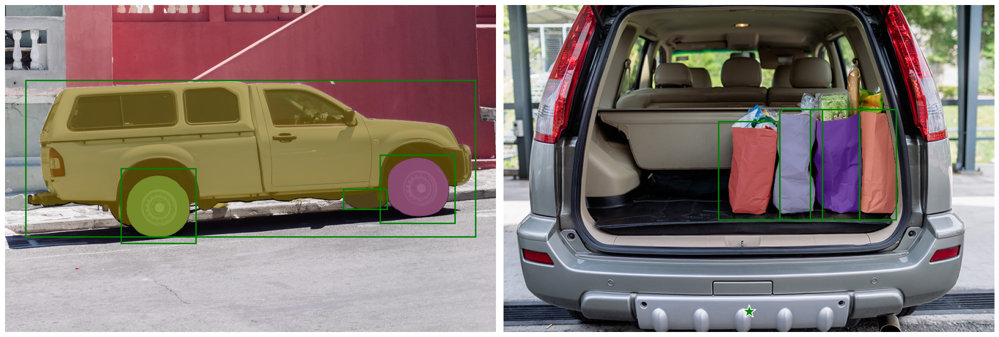

In [81]:
fig, ax = plt.subplots(1, 2, figsize=(20, 20))

ax[0].imshow(image1)
for mask in batched_output[0]['masks']:
    show_mask(mask.cpu().numpy(), ax[0], random_color=True)
for box in image1_boxes:
    show_box(box.cpu().numpy(), ax[0])
for point, label in zip(image1_points, image1_points_labels):
    show_points(point.cpu().numpy(), label.cpu().numpy(), plt.gca())
ax[0].axis('off')

ax[1].imshow(image2)
for mask in batched_output[1]['masks']:
    show_mask(mask.cpu().numpy(), ax[1], random_color=True)
for box in image2_boxes:
    show_box(box.cpu().numpy(), ax[1])
ax[1].axis('off')

plt.tight_layout()
plt.show()